# TODO
* Define model target
* Check shap feature importance set seed of umap
* Analyze important features by cluster
* Subsample dataset with relevant types of cancer related with mutations in NF1, NF2, SMARCB1 and/or LZTR1

 * https://www.mayoclinic.org/es-es/diseases-conditions/neurofibromatosis/symptoms-causes/syc-20350490
 * https://www.nhs.uk/conditions/neurofibromatosis-type-1/
 * https://www.thieme-connect.com/products/ejournals/abstract/10.1055/s-0034-1382021
 * https://pubmed.ncbi.nlm.nih.gov/25062113/

In [1]:
import pandas as pd
import plotly.express as px

import numpy as np
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import umap.umap_ as umap
import hdbscan
import lightgbm as lgb

from sklearn.model_selection import train_test_split

from sklearn import metrics
import shap

from kmeans_interp.kmeans_feature_imp import KMeansInterp

#pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)

C:\Users\lucas\anaconda3\envs\hack4nf\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
df_clinical = pd.read_csv("data/genie/data_clinical.txt", sep="\t")
df_fusions = pd.read_csv("data/genie/data_fusions.txt", sep="\t")
df_CNA = pd.read_csv("data/genie/data_CNA.txt", sep="\t")
df_mutations = pd.read_csv("data/genie/data_mutations_extended.txt", sep="\t", skiprows=1)
df_combined = pd.read_csv("data/genie/genie_combined.bed", sep="\t")
df_hg19 = pd.read_csv("data/genie/genie_data_cna_hg19.seg", sep="\t")

Columns (17,18,23,24,25,29) have mixed types. Specify dtype option on import or set low_memory=False.


In [5]:
df_fusions.head()

,HUGO_SYMBOL,CENTER,TUMOR_SAMPLE_BARCODE,FUSION,DNA_SUPPORT,RNA_SUPPORT,FRAME,COMMENTS
0,ABCA5,VICC,GENIE-VICC-565922-unk-1,ABCA5-CDK12 fusion,yes,unknown,unknown,NaN
1,ABL1,VICC,GENIE-VICC-612351-unk-1,ABL1-FCN2 fusion,yes,unknown,unknown,NaN
2,ABLIM2,VICC,GENIE-VICC-943592-unk-1,ABLIM2-PDGFRA fusion,yes,unknown,unknown,NaN
3,ACACA,VICC,GENIE-VICC-665767-unk-1,ACACA-CDK12 fusion,yes,unknown,unknown,NaN
4,ACACB,VICC,GENIE-VICC-531696-unk-1,ACACB-CHD2 fusion,yes,unknown,unknown,NaN


In [7]:
df_clinical.columns

Index(['AGE_AT_SEQ_REPORT', 'CENTER', 'ETHNICITY', 'ONCOTREE_CODE',
       'PATIENT_ID', 'PRIMARY_RACE', 'SAMPLE_ID', 'SAMPLE_TYPE',
       'SEQ_ASSAY_ID', 'SEX', 'CANCER_TYPE', 'CANCER_TYPE_DETAILED'],
      dtype='object')

In [8]:
df_CNA_cols = list(df_CNA.columns)
df_CNA_cols.pop(0)
len(df_clinical[df_clinical["SAMPLE_ID"].isin(df_CNA_cols)])

14310

# IMPORTANT! Keep only patients that appear in data_mutations_extended

In [9]:
len(df_clinical)

18804

In [10]:
df_clinical["have_mutation"] = df_clinical["SAMPLE_ID"].isin(df_mutations["Tumor_Sample_Barcode"])
df_clinical = df_clinical[df_clinical["have_mutation"]].reset_index(drop=True)

In [11]:
len(df_clinical)

17005

In [12]:
df_clinical["is_NF1"] = df_clinical["SAMPLE_ID"].isin(df_mutations[df_mutations["Hugo_Symbol"]=="NF1"]["Tumor_Sample_Barcode"])
df_clinical["is_NF2"] = df_clinical["SAMPLE_ID"].isin(df_mutations[df_mutations["Hugo_Symbol"]=="NF2"]["Tumor_Sample_Barcode"])
df_clinical["is_SMARCB1"] = df_clinical["SAMPLE_ID"].isin(df_mutations[df_mutations["Hugo_Symbol"]=="SMARCB1"]["Tumor_Sample_Barcode"])
df_clinical["is_LZTR1"] = df_clinical["SAMPLE_ID"].isin(df_mutations[df_mutations["Hugo_Symbol"]=="LZTR1"]["Tumor_Sample_Barcode"])

### Patients with NF1 mutation

In [13]:
len(df_clinical[df_clinical["is_NF1"]])

911

### cancer_type in NF1 mutation

In [14]:
df_clinical[df_clinical["is_NF1"]]["CANCER_TYPE"].value_counts()

Non-Small Cell Lung Cancer               167
Glioma                                   133
Breast Cancer                             99
Melanoma                                  90
Colorectal Cancer                         54
Bladder Cancer                            51
Endometrial Cancer                        50
Ovarian Cancer                            34
Skin Cancer, Non-Melanoma                 30
Soft Tissue Sarcoma                       22
Leukemia                                  20
Esophagogastric Cancer                    17
Cancer of Unknown Primary                 16
Hepatobiliary Cancer                      14
Prostate Cancer                           13
Thyroid Cancer                            12
Gastrointestinal Stromal Tumor             9
Head and Neck Cancer                       7
Small Bowel Cancer                         6
Renal Cell Carcinoma                       6
Uterine Sarcoma                            5
Adrenocortical Carcinoma                   5
Non-Hodgki

### Patients with NF2 mutation

In [15]:
len(df_clinical[df_clinical["is_NF2"]])

282

### cancer_type in NF2 mutation

In [16]:
df_clinical[df_clinical["is_NF2"]]["CANCER_TYPE"].value_counts()

Mesothelioma                      34
Non-Small Cell Lung Cancer        32
Renal Cell Carcinoma              30
CNS Cancer                        25
Bladder Cancer                    15
Breast Cancer                     15
Skin Cancer, Non-Melanoma         14
Melanoma                          14
Colorectal Cancer                 13
Glioma                            12
Endometrial Cancer                11
Cancer of Unknown Primary         10
Ovarian Cancer                     8
Thyroid Cancer                     7
Soft Tissue Sarcoma                7
Head and Neck Cancer               6
Nerve Sheath Tumor                 6
Pancreatic Cancer                  5
Esophagogastric Cancer             5
Cervical Cancer                    3
Embryonal Tumor                    2
Uterine Sarcoma                    2
Salivary Gland Cancer              1
Miscellaneous Brain Tumor          1
Leukemia                           1
Gastrointestinal Stromal Tumor     1
Hepatobiliary Cancer               1
P

### Patients with SMARCB1 mutation

In [17]:
len(df_clinical[df_clinical["is_SMARCB1"]])

141

### cancer_type in SMARCB1 mutation

In [18]:
df_clinical[df_clinical["is_SMARCB1"]]["CANCER_TYPE"].value_counts()

Colorectal Cancer             25
Non-Small Cell Lung Cancer    23
Bladder Cancer                12
Breast Cancer                 12
Renal Cell Carcinoma           9
Glioma                         7
Skin Cancer, Non-Melanoma      5
Endometrial Cancer             4
Thyroid Cancer                 4
Melanoma                       4
Soft Tissue Sarcoma            4
Leukemia                       3
Esophagogastric Cancer         3
CNS Cancer                     3
Cancer of Unknown Primary      3
Ovarian Cancer                 2
Salivary Gland Cancer          2
Head and Neck Cancer           2
Non-Hodgkin Lymphoma           2
Hepatobiliary Cancer           2
Prostate Cancer                1
Appendiceal Cancer             1
Mesothelioma                   1
Pancreatic Cancer              1
Thymic Tumor                   1
Penile Cancer                  1
Wilms Tumor                    1
Cervical Cancer                1
Anal Cancer                    1
Small Bowel Cancer             1
Name: CANC

### Patients with LZTR1 mutation

In [19]:
len(df_clinical[df_clinical["is_LZTR1"]])

12

### cancer_type in LZTR mutation

In [20]:
df_clinical[df_clinical["is_LZTR1"]]["CANCER_TYPE"].value_counts()

Breast Cancer                 2
Colorectal Cancer             2
Melanoma                      2
Small Bowel Cancer            1
Cancer of Unknown Primary     1
Salivary Gland Cancer         1
Glioma                        1
Non-Small Cell Lung Cancer    1
Pancreatic Cancer             1
Name: CANCER_TYPE, dtype: int64

## Bar plot with % of each cancer_type by relevant mutations
1. Calculate % of each cancer_type in the dataset
2. Calculate % of each cancer_type in patients with relevant mutations

In [21]:
cancer_type_counts = df_clinical["CANCER_TYPE"].value_counts()
df_cancer_type = pd.DataFrame(cancer_type_counts).reset_index()
df_cancer_type.columns = ["cancer_type", "count"]
df_cancer_type["pct"] = df_cancer_type["count"]/df_cancer_type["count"].sum()*100
df_cancer_type["pct"] = df_cancer_type["pct"].round(3)
df_cancer_type["mutation"] = "All"
df_cancer_type = df_cancer_type.sort_values("pct")

In [22]:
def add_pct_of_mutation(df_cancer_type, df_clinical, mutation):
    '''
    Add new column with count and % for each mutation
    '''
    cancer_type_counts_mut = df_clinical[df_clinical[f"is_{mutation}"]]["CANCER_TYPE"].value_counts()
    df_cancer_type_mut = pd.DataFrame(cancer_type_counts_mut).reset_index()
    df_cancer_type_mut.columns = ["cancer_type", f"count_{mutation}"]
    df_cancer_type = pd.merge(df_cancer_type, df_cancer_type_mut, on ="cancer_type", how="left")
    df_cancer_type[f"{mutation}_pct"] = df_cancer_type[f"count_{mutation}"]/df_cancer_type[f"count_{mutation}"].sum()*100
    df_cancer_type[f"{mutation}_pct"] = df_cancer_type[f"{mutation}_pct"].round(3)
    return df_cancer_type

In [23]:
def append_pct_of_mutation(df_cancer_type, df_clinical, mutation):
    '''
    Append count and percentage of each cancer type by mutation
    The resulting dataframe can be used to by plotted in one bar chart.
    '''
    cancer_type_counts_mut = df_clinical[df_clinical[f"is_{mutation}"]]["CANCER_TYPE"].value_counts()
    df_cancer_type_mut = pd.DataFrame(cancer_type_counts_mut).reset_index()
    df_cancer_type_mut.columns = ["cancer_type", "count"]
    df_cancer_type_mut["mutation"] = mutation
    df_cancer_type_mut["pct"] = df_cancer_type_mut["count"]/df_cancer_type_mut["count"].sum()*100
    df_cancer_type_mut["pct"] = df_cancer_type_mut["pct"].round(3)
    df_cancer_type = pd.concat([df_cancer_type, df_cancer_type_mut])
    return df_cancer_type

In [24]:
df_cancer_type = append_pct_of_mutation(df_cancer_type, df_clinical, "NF1")
df_cancer_type = append_pct_of_mutation(df_cancer_type, df_clinical, "NF2")
df_cancer_type = append_pct_of_mutation(df_cancer_type, df_clinical, "SMARCB1")
df_cancer_type = append_pct_of_mutation(df_cancer_type, df_clinical, "LZTR1")

In [25]:
df_cancer_type.reset_index(inplace=True, drop=True)

In [26]:
df_cancer_type = df_cancer_type.fillna(0)

In [27]:
df_cancer_type.head()

,cancer_type,count,pct,mutation
0,Choroid Plexus Tumor,1,0.006,All
1,Breast Sarcoma,3,0.018,All
2,Retinoblastoma,3,0.018,All
3,Pineal Tumor,5,0.029,All
4,Hodgkin Lymphoma,6,0.035,All


## Visualize % of cancer type by mutation

In [28]:
fig = px.bar(df_cancer_type[df_cancer_type["mutation"]=="All"], 
             y='cancer_type', x='pct',
             orientation='h', height=800)
fig.show()

In [29]:
fig = px.bar(df_cancer_type, 
             y='cancer_type', x='pct', color = "mutation", barmode = "group",
             orientation='h', height=1600)
fig.show()

### Dimensional reduction 

In [30]:
df_CNA_cols = list(df_CNA.columns)
df_CNA_cols.pop(0)
len(df_clinical[df_clinical["SAMPLE_ID"].isin(df_CNA_cols)])

13449

In [31]:
df_clinical["is_in_CNA"] = df_clinical["SAMPLE_ID"].isin(df_CNA_cols)
df_clinical = df_clinical[df_clinical["is_in_CNA"]].reset_index(drop=True)

In [32]:
len(df_clinical)

13449

In [33]:
df_clinical["AGE_AT_SEQ_REPORT"] = df_clinical["AGE_AT_SEQ_REPORT"].replace("<18y", 18)
df_clinical["AGE_AT_SEQ_REPORT"] = df_clinical["AGE_AT_SEQ_REPORT"].replace(">89y", 89)
df_clinical["AGE_AT_SEQ_REPORT"] = df_clinical["AGE_AT_SEQ_REPORT"].astype(int)

In [34]:
df_CNA = df_CNA.set_index("HUGO_SYMBOL")
df_CNA_id =df_CNA.T
df_CNA_id.reset_index(inplace=True)
df_CNA_id = df_CNA_id.rename(columns={"index":"SAMPLE_ID"})

df_clinical_CNA = pd.merge(df_clinical, df_CNA_id, on="SAMPLE_ID", how="left")

In [35]:
df_CNA_HUGO_SYMBOLS_cols = list(df_CNA_id.columns)
df_CNA_HUGO_SYMBOLS_cols.pop(0)

'SAMPLE_ID'

In [36]:
features = ["AGE_AT_SEQ_REPORT"]+df_CNA_HUGO_SYMBOLS_cols

In [37]:
df_clinical_CNA_scaled = StandardScaler().fit_transform(df_clinical_CNA[features].values)
df_clinical_CNA_scaled = pd.DataFrame(df_clinical_CNA_scaled)
df_clinical_CNA_scaled.columns = features

In [45]:
df_clinical_CNA[features[1:]].sum(axis=1).describe()

count    13449.000000
mean         0.963269
std         16.090740
min       -180.000000
25%          0.000000
50%          0.000000
75%          4.000000
max        174.000000
dtype: float64

<AxesSubplot:>

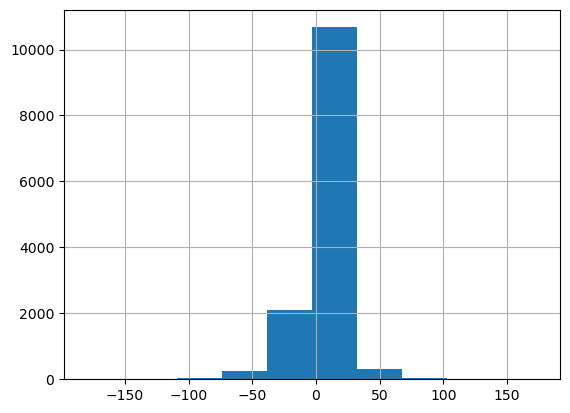

In [46]:
# Sum of values of CNA
df_clinical_CNA[features[1:]].sum(axis=1).hist()

In [47]:
df_clinical_CNA[features[1:]].abs().sum(axis=1).describe()

count    13449.000000
mean        16.641312
std         27.928186
min          0.000000
25%          0.000000
50%          4.000000
75%         20.000000
max        340.000000
dtype: float64

<AxesSubplot:>

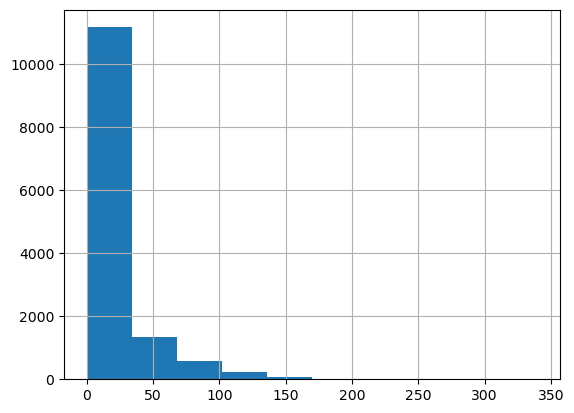

In [48]:
df_clinical_CNA[features[1:]].abs().sum(axis=1).hist()

In [165]:
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(df_clinical_CNA_scaled[df_CNA_HUGO_SYMBOLS_cols])
embedding.shape

(13449, 2)

In [166]:
df_clinical_CNA['CANCER_TYPE_ID'] = df_clinical_CNA['CANCER_TYPE'].astype('category').cat.codes

In [167]:
df_clinical_CNA["UMAP_X"] = embedding[:, 0]
df_clinical_CNA["UMAP_Y"] = embedding[:, 1]

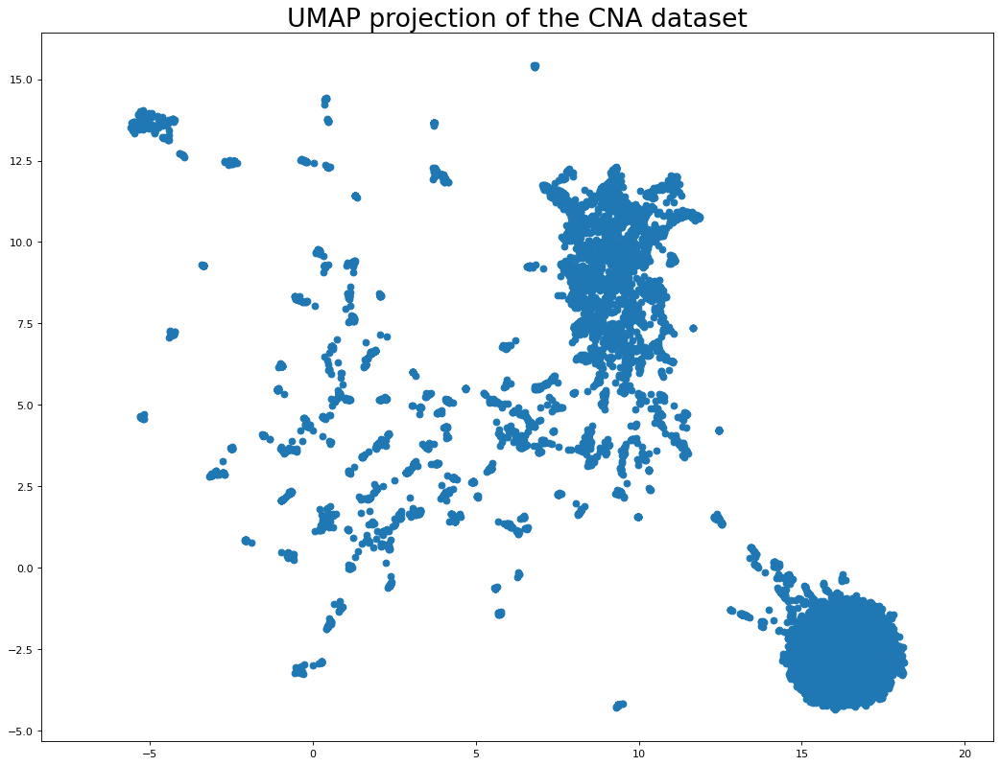

In [168]:
plt.figure(figsize=(16, 12), dpi=80)
plt.scatter(
    df_clinical_CNA["UMAP_X"],
    df_clinical_CNA["UMAP_Y"]
)
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the CNA dataset', fontsize=24);

In [169]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="CANCER_TYPE",
                 hover_data=['CANCER_TYPE'])
fig.show()

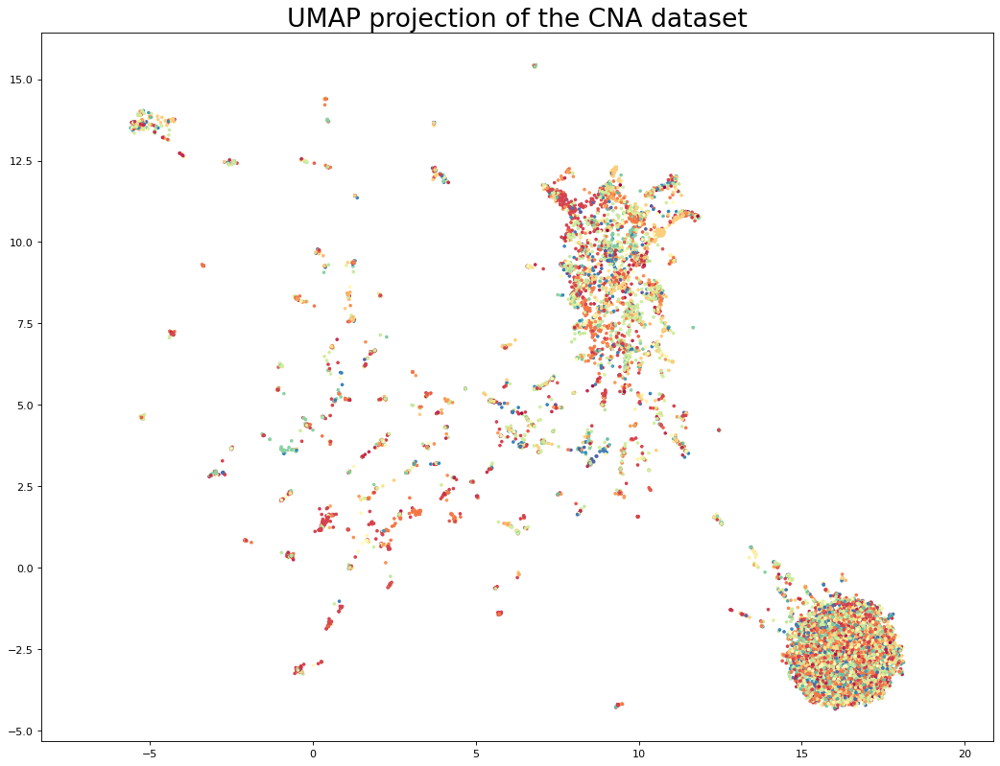

In [170]:
plt.figure(figsize=(16, 12), dpi=80)
plt.scatter(df_clinical_CNA["UMAP_X"], df_clinical_CNA["UMAP_Y"], c=df_clinical_CNA["CANCER_TYPE_ID"], cmap='Spectral', s=5)
plt.gca().set_aspect('equal', 'datalim')
#plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(len(df_clinical_CNA["CANCER_TYPE_ID"].unique())))
plt.title('UMAP projection of the CNA dataset', fontsize=24);

In [171]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="is_NF1",
                 hover_data=['CANCER_TYPE'])
fig.show()

In [172]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="is_NF2",
                 hover_data=['CANCER_TYPE'])
fig.show()

In [173]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="is_SMARCB1",
                 hover_data=['CANCER_TYPE'])
fig.show()

In [182]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=100).fit(df_clinical_CNA[["UMAP_X", "UMAP_Y"]])
df_clinical_CNA["cluster"] = clusterer.labels_+1
df_clinical_CNA["cluster_str"] = df_clinical_CNA["cluster"].apply(lambda x: f"cluster_{x}") 

In [183]:
len(df_clinical_CNA["cluster"].unique())

11

In [184]:
df_clinical_CNA["cluster"].value_counts()

2     5976
10    3631
0     2331
8      384
4      341
7      183
1      147
5      131
3      116
6      106
9      103
Name: cluster, dtype: int64

In [185]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="cluster_str",
                 hover_data=['CANCER_TYPE'])
fig.show()

In [186]:
fig = px.scatter(df_clinical_CNA, x="UMAP_X", y="UMAP_Y", color="CANCER_TYPE",
                 hover_data=['CANCER_TYPE'])
fig.show()

### Lightgbm model to predict cluseter

In [187]:
num_classes = len(df_clinical_CNA["cluster"].unique())
X_train, X_test, y_train, y_test = train_test_split(df_clinical_CNA[features], df_clinical_CNA["cluster"], test_size=0.33, random_state=42)

train_data = lgb.Dataset(X_train, label=y_train)
test_data = lgb.Dataset(X_test, label=y_test)

params_k = {
            'boosting_type': 'gbdt',
            'objective': 'multiclass',
            'num_class':num_classes,
            'subsample': 0.8,
            'subsample_freq': 1,
            'learning_rate': 0.05,
            'feature_fraction': 0.8,
            'max_bin': 300,
            'n_estimators': 500,
            'boost_from_average': False,
            "random_seed":42}

model_gbm = lgb.train(params_k, train_data, valid_sets=[test_data],
                  num_boost_round=2000, early_stopping_rounds=25,
                  verbose_eval=25)

C:\Users\lucas\anaconda3\envs\hack4nf\lib\site-packages\lightgbm\engine.py:177: UserWarning:

Found `n_estimators` in params. Will use it instead of argument

C:\Users\lucas\anaconda3\envs\hack4nf\lib\site-packages\lightgbm\engine.py:181: UserWarning:

'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.

C:\Users\lucas\anaconda3\envs\hack4nf\lib\site-packages\lightgbm\engine.py:239: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1608
[LightGBM] [Info] Number of data points in the train set: 9010, number of used features: 352
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 25 rounds
[25]	valid_0's multi_logloss: 0.52629
[50]	valid_0's multi_logloss: 0.345126
[75]	valid_0's multi_logloss: 0.304752
[100]	valid_0's multi_logloss: 0.295921
[125]	valid_0's multi_logloss: 0.296412
Early stoppi

### Model metrics 

In [188]:
y_pred = model_gbm.predict(X_test)
predictions = []

for x in y_pred:
    predictions.append(np.argmax(x))
    
print("Overall Accuracy:",metrics.accuracy_score(y_test, predictions))
print("Overall Precision:",metrics.precision_score(y_test, predictions, average='macro'))
print("Overall Recall:",metrics.recall_score(y_test, predictions, average='macro'))

Overall Accuracy: 0.9128182022978149
Overall Precision: 0.8216723180807961
Overall Recall: 0.7294854474700402


In [189]:
print(metrics.classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.85      0.80      0.82       746
           1       0.86      0.84      0.85        50
           2       0.94      0.97      0.95      2012
           3       0.80      0.57      0.67        35
           4       0.85      0.93      0.89        99
           5       0.98      0.79      0.88        53
           6       0.75      0.55      0.64        38
           7       0.76      0.42      0.54        60
           8       0.77      0.66      0.71       123
           9       0.55      0.52      0.53        23
          10       0.94      0.97      0.96      1200

    accuracy                           0.91      4439
   macro avg       0.82      0.73      0.77      4439
weighted avg       0.91      0.91      0.91      4439



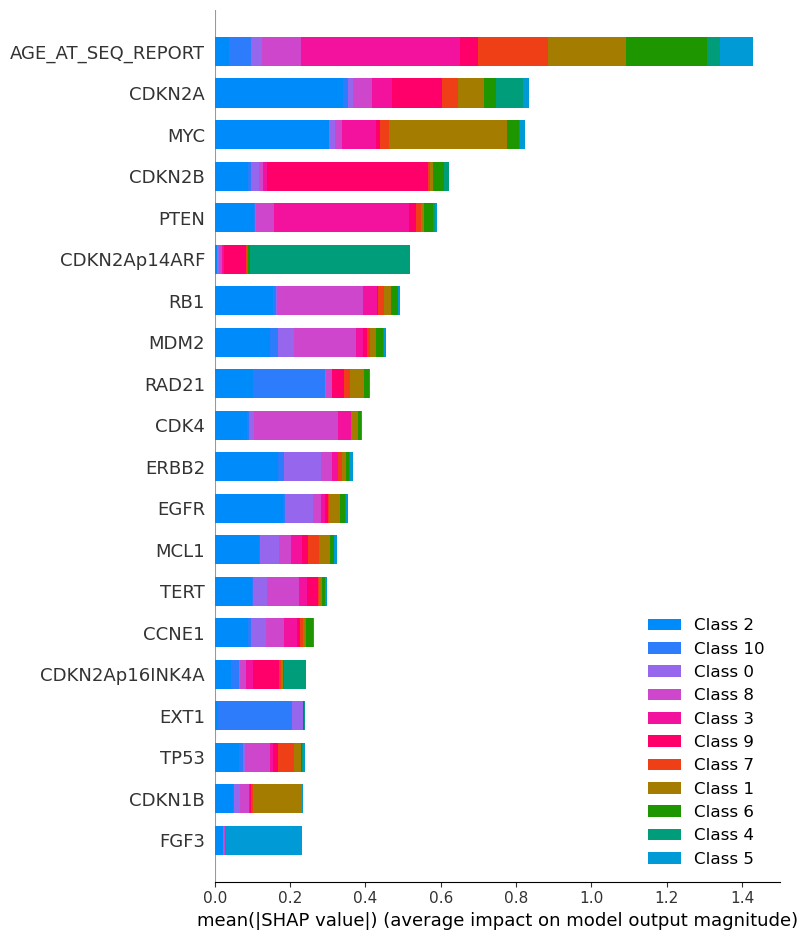

In [190]:
shap_values = shap.TreeExplainer(model_gbm).shap_values(X_test)
shap.summary_plot(shap_values, X_test)

In [191]:
len(shap_values)

11

In [192]:
shap_values[0].shape

(4439, 612)

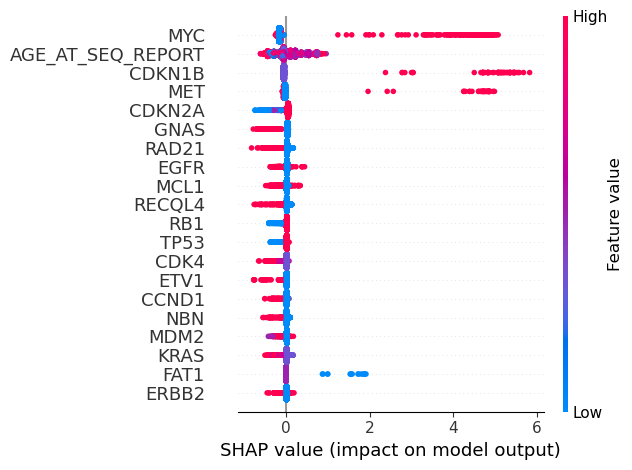

In [202]:
shap.summary_plot(shap_values[1], X_test, show=False, plot_size=None)

### MYC is the most important feature by shap to predict the cluster 1
* Higher values of MYC produce a higher probability of prediction for class 1
* 55.4% of patientsof cluster 1 have mutation in MYC (94)
* Compare with the other clusters, only ~11%

In [206]:
len(df_clinical_CNA[df_clinical_CNA["cluster"]==1])

147

In [207]:
df_clinical_CNA[df_clinical_CNA["cluster"]==1]["MYC"].value_counts(normalize=True)

2.0    0.544218
0.0    0.448980
1.0    0.006803
Name: MYC, dtype: float64

In [208]:
df_clinical_CNA[df_clinical_CNA["cluster"]!=1]["MYC"].value_counts(normalize=True)

 0.0    0.875583
 1.0    0.088784
 2.0    0.030672
-1.0    0.004962
Name: MYC, dtype: float64

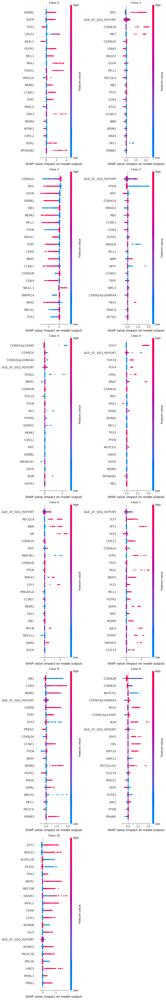

In [200]:
total_rows = len(shap_values)//2+1
total_cols = 2
plt.figure(figsize=(10,10*total_rows))
for plot_n in range(len(shap_values)):
    plt.subplot(total_rows,total_cols,plot_n+1)
    shap.summary_plot(shap_values[plot_n], X_test, show=False, plot_size=None)
    plt.title(f"Class {plot_n}")

Feature importance SHAP for class 0


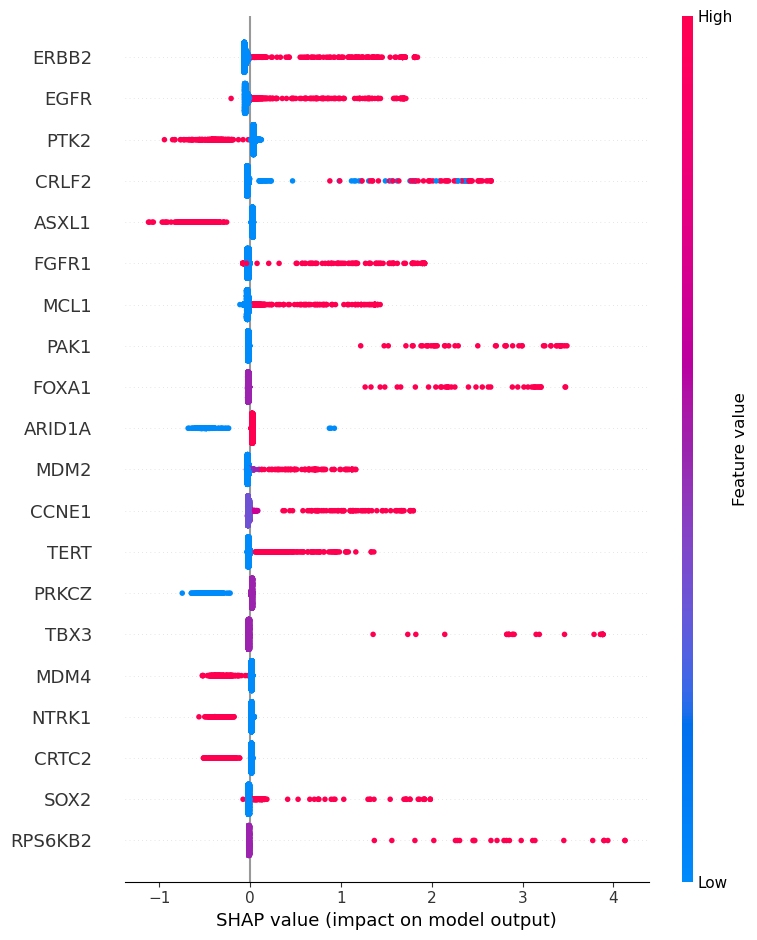

Feature importance SHAP for class 1


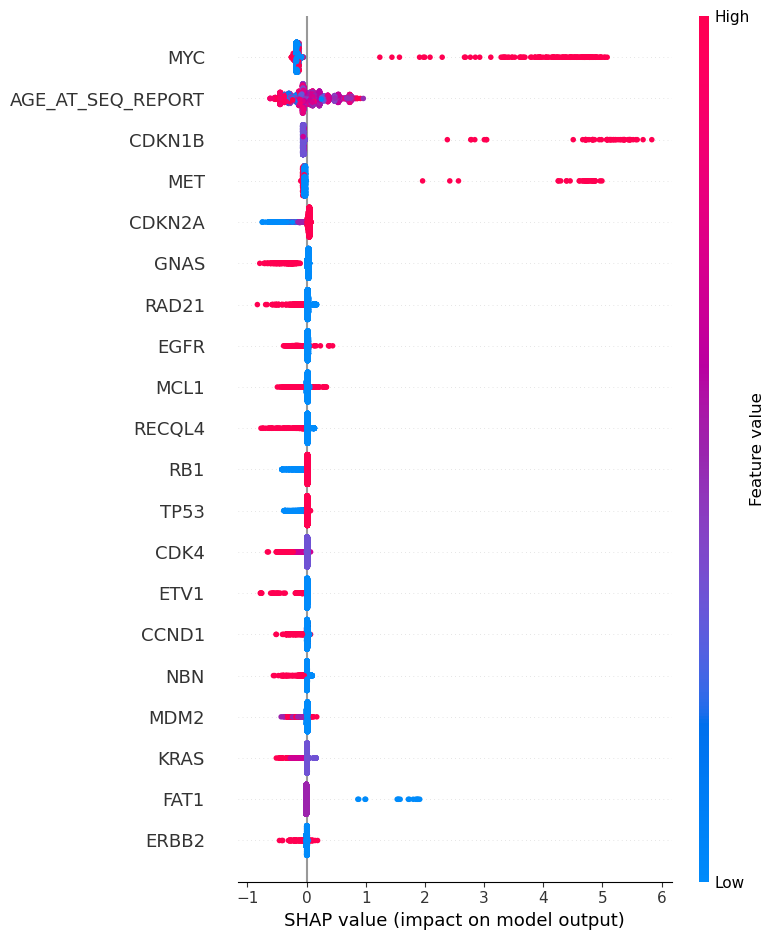

Feature importance SHAP for class 2


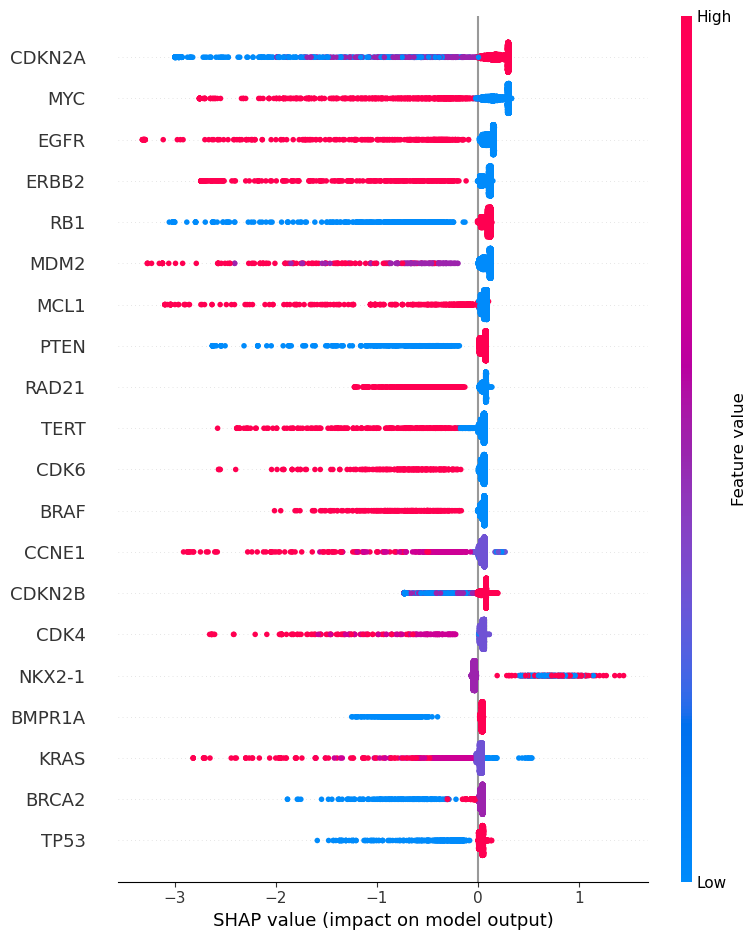

Feature importance SHAP for class 3


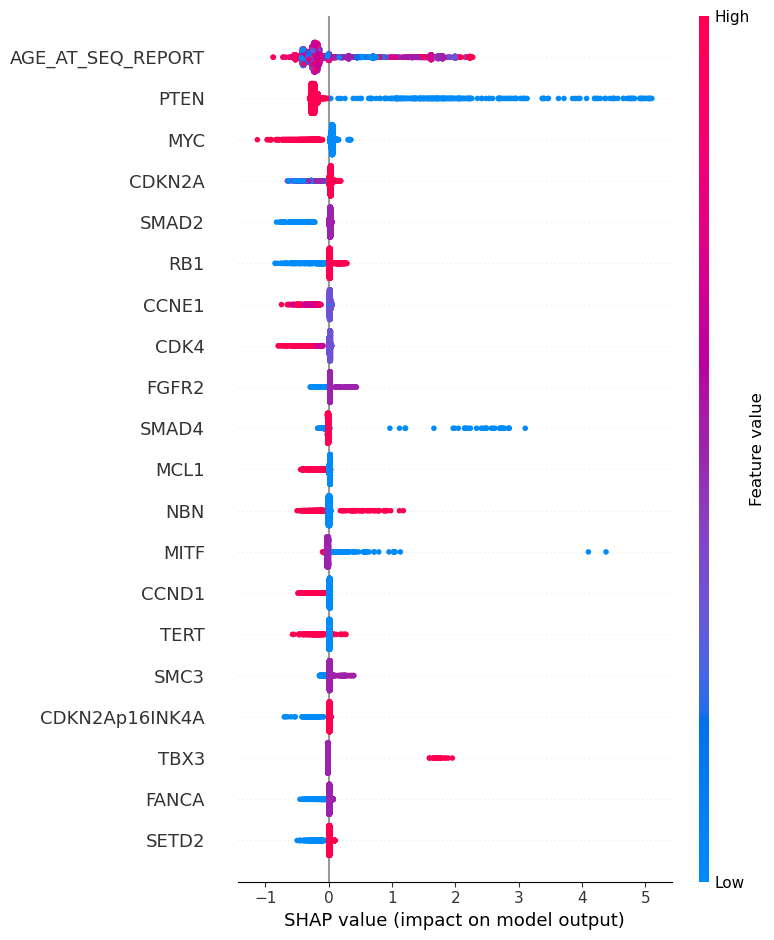

Feature importance SHAP for class 4


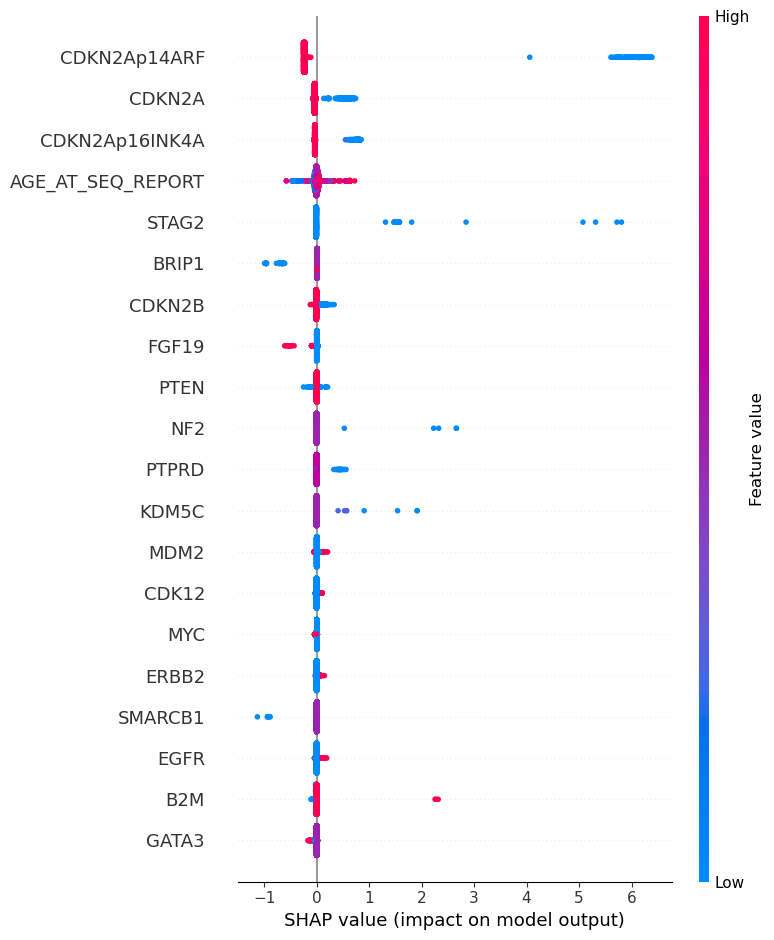

Feature importance SHAP for class 5


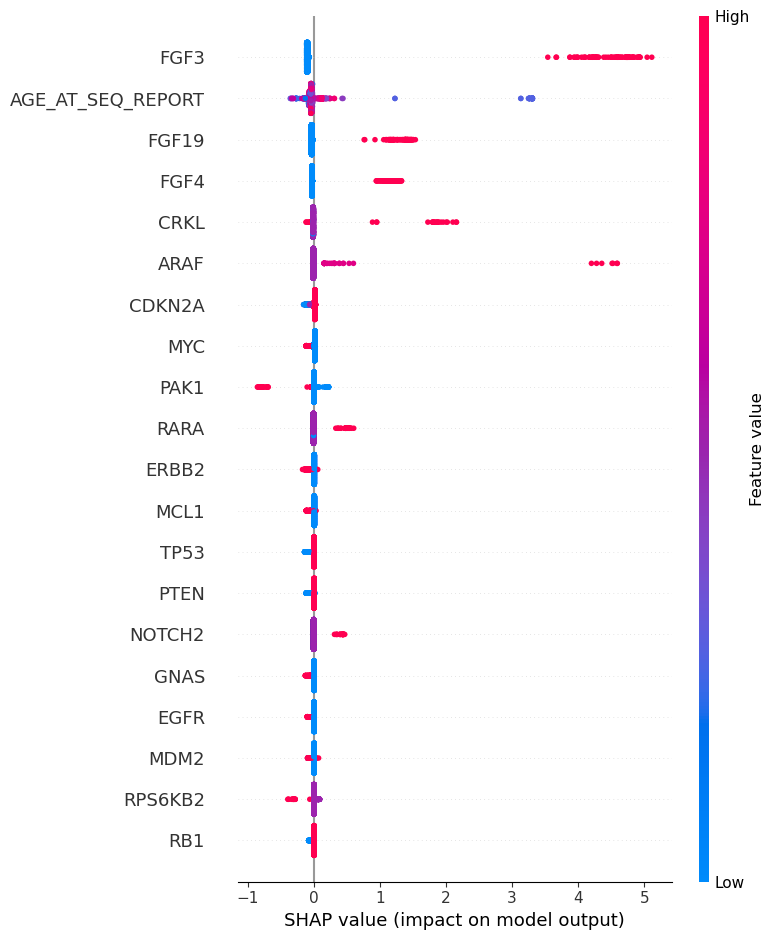

Feature importance SHAP for class 6


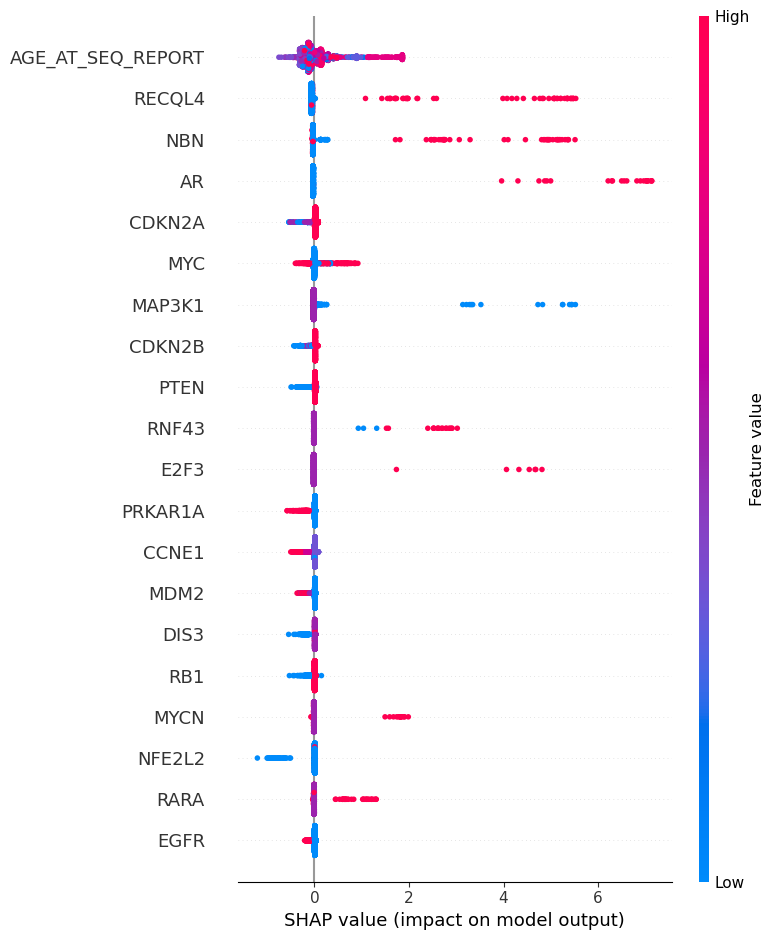

Feature importance SHAP for class 7


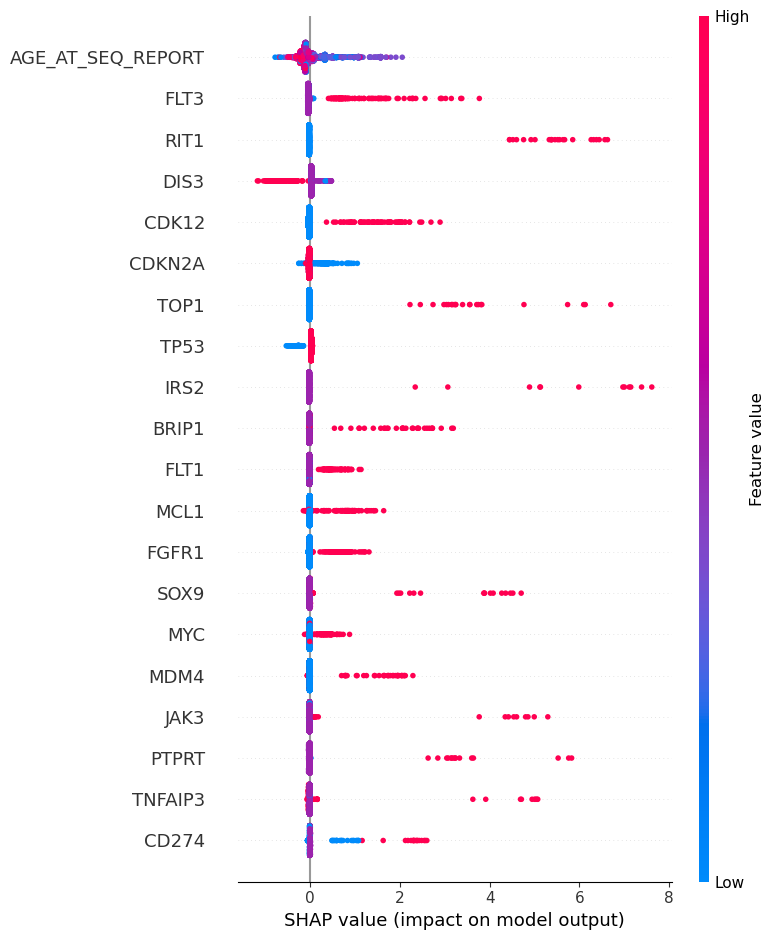

Feature importance SHAP for class 8


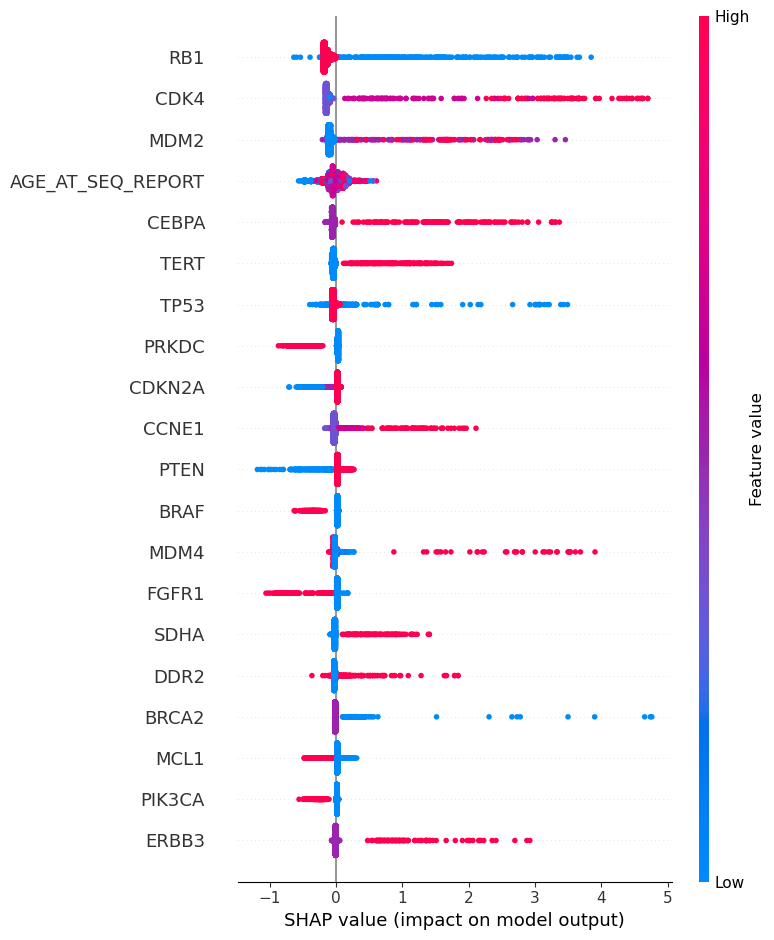

Feature importance SHAP for class 9


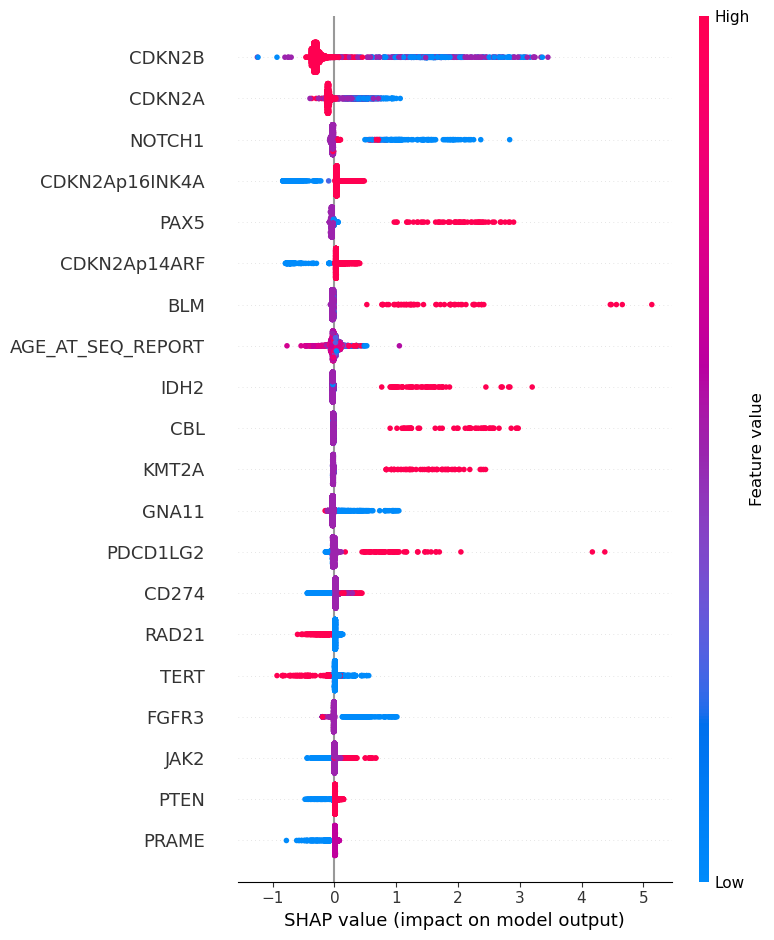

Feature importance SHAP for class 10


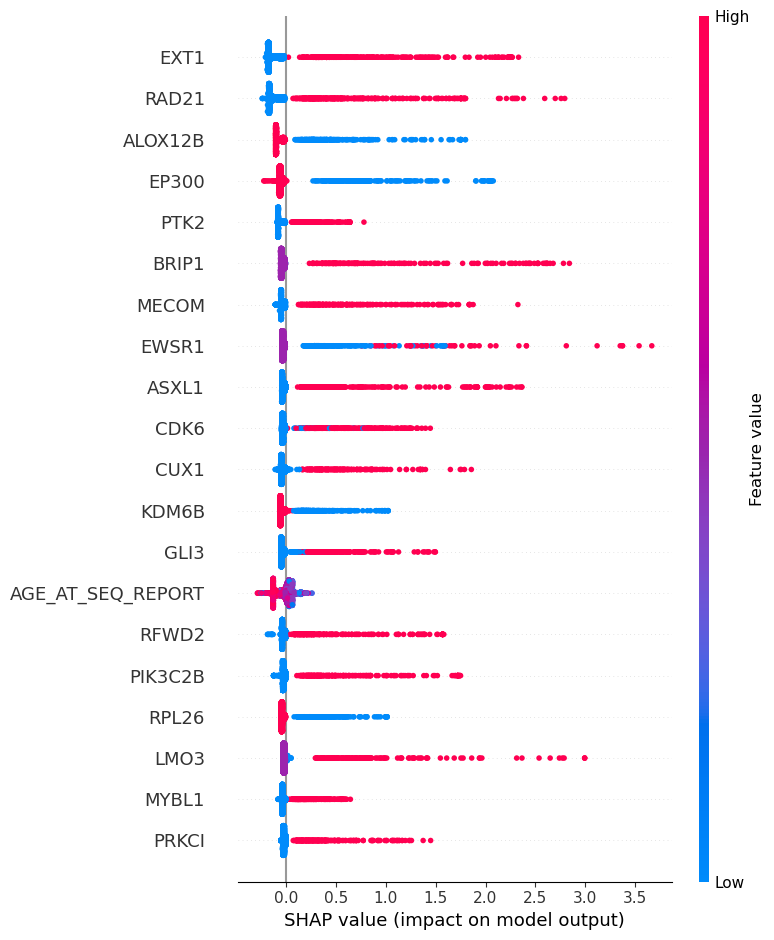

In [201]:
for n_class in range(len(shap_values)):
    print(f"Feature importance SHAP for class {n_class}")
    shap.summary_plot(shap_values[n_class], X_test)

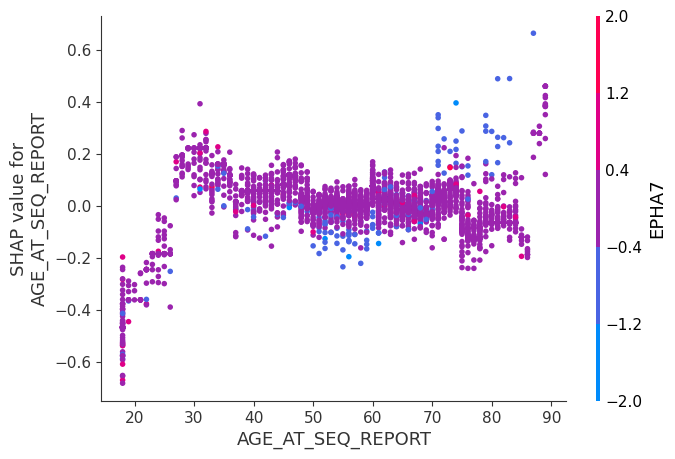

In [72]:
# If we pass a numpy array instead of a data frame then we
# need pass the feature names in separately
shap.dependence_plot(0, shap_values[0], X_test.values, feature_names=X_test.columns)

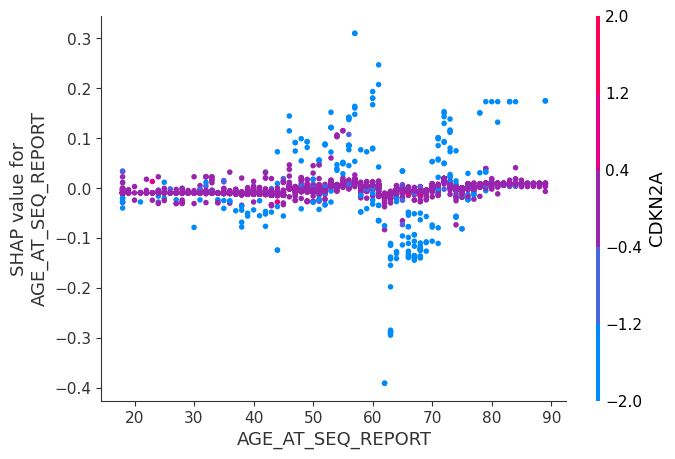

In [73]:
shap.dependence_plot(0, shap_values[1], X_test.values, feature_names=X_test.columns)

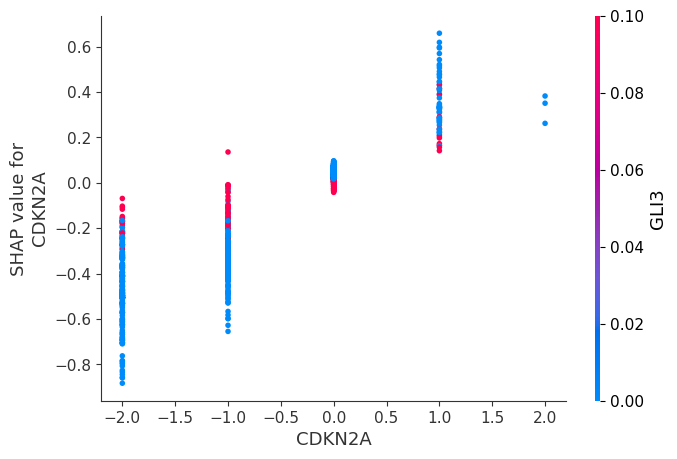

In [90]:
shap.dependence_plot("CDKN2A", shap_values[0], X_test.values, feature_names=X_test.columns)

In [74]:
tree_explainer = shap.TreeExplainer(model_gbm)

In [75]:
shap.initjs()

In [76]:
patient_index=8
shap.force_plot(tree_explainer.expected_value[0], shap_values[0][patient_index], X_test.values[patient_index], feature_names = X_test.columns)

In [96]:
#!git clone https://github.com/YousefGh/kmeans-feature-importance.git

Cloning into 'kmeans-feature-importance'...


In [136]:

kms = KMeansInterp(
    n_clusters=num_classes, # Set the number of clusters to the number of actual unique categories
    random_state=1, 
    ordered_feature_names=features, # This method gets the feature names (Words) from
    feature_importance_method='wcss_min', # Or 'unsup2sup'
).fit(df_clinical_CNA_scaled[features])

# Create a new column to the dataset which will have cluster labels
labels = kms.labels_
df_clinical_CNA['Cluster_kms_wcss_min'] = labels

In [119]:
len(df_clinical_CNA['Cluster_kms_wcss_min'].unique())

15

In [120]:
kms.feature_importances_[0][:10] # Features here are words

[('RFWD2', 0.20493825933804694),
 ('CDC73', 0.20164107063709114),
 ('SDHC', 0.19942189228735943),
 ('H3F3A', 0.19808245422151813),
 ('DDR2', 0.19350505886508676),
 ('CRTC2', 0.19033956383735173),
 ('PIK3C2B', 0.18714915659148082),
 ('SBDS', 0.18209081848816422),
 ('FH', 0.18027870495617035),
 ('AKT3', 0.17994185424648254)]

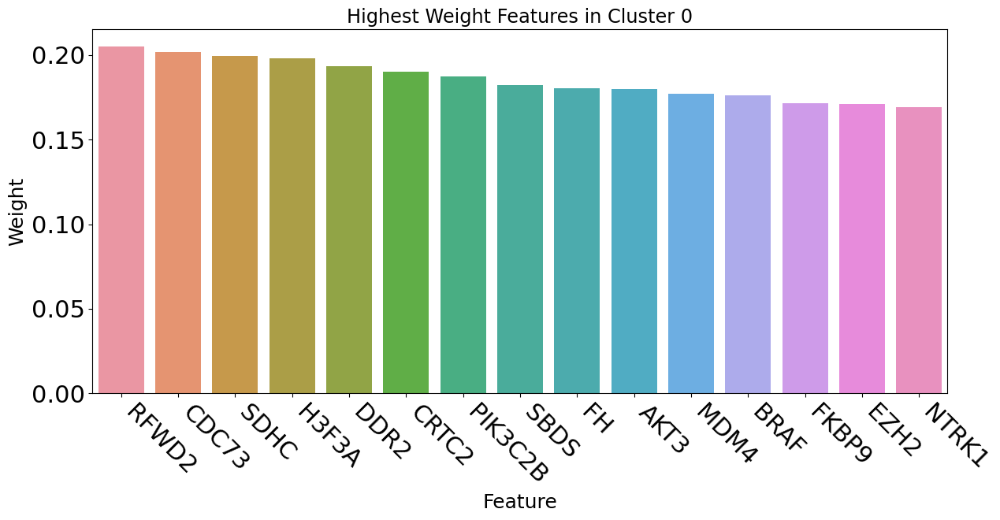

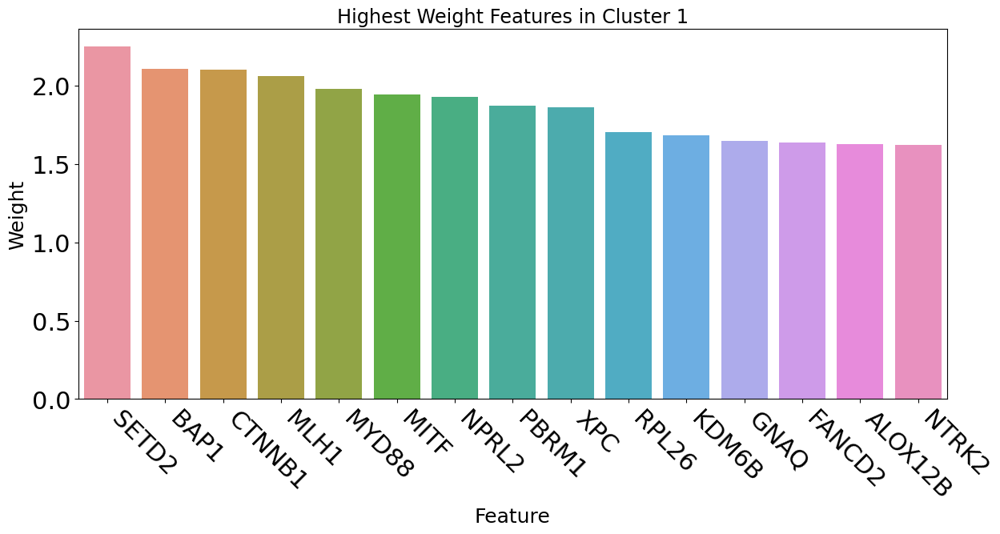

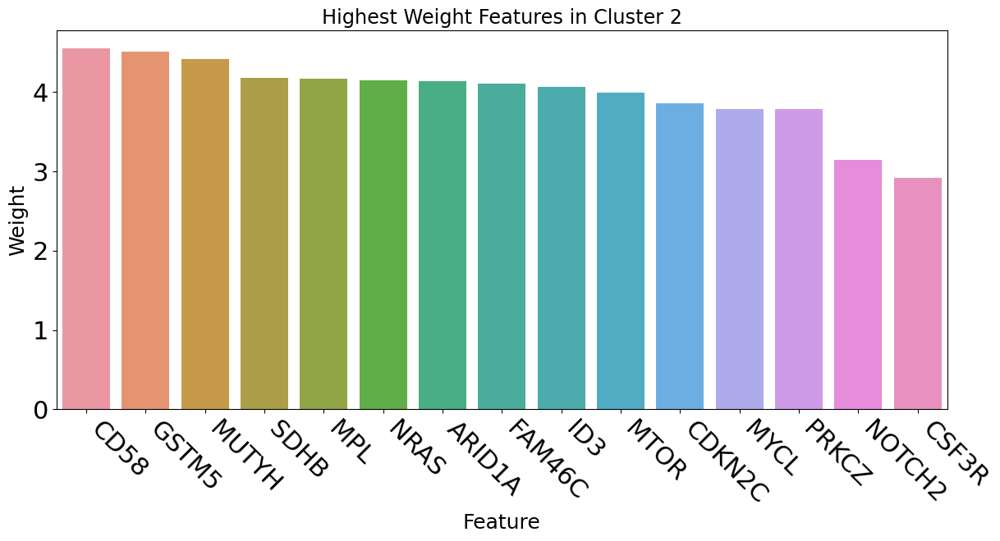

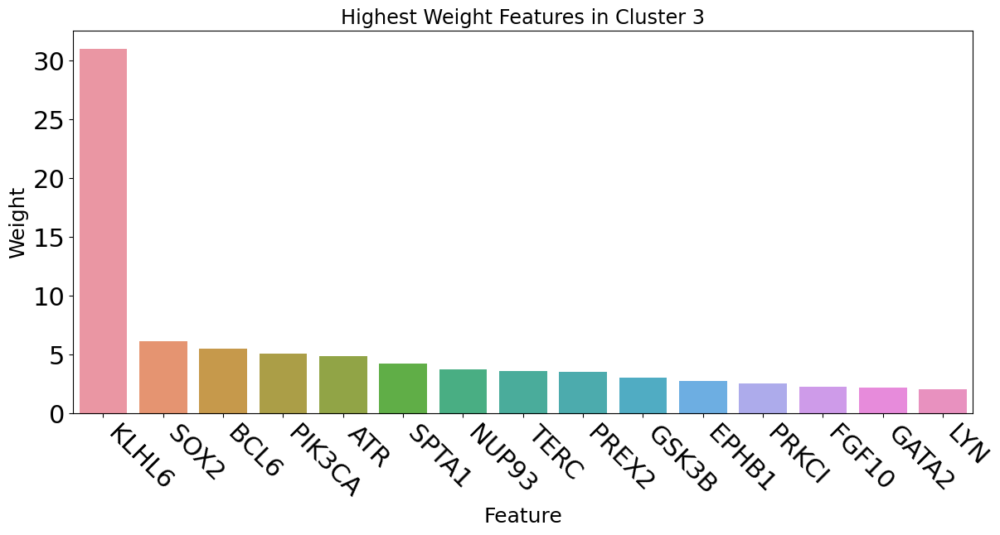

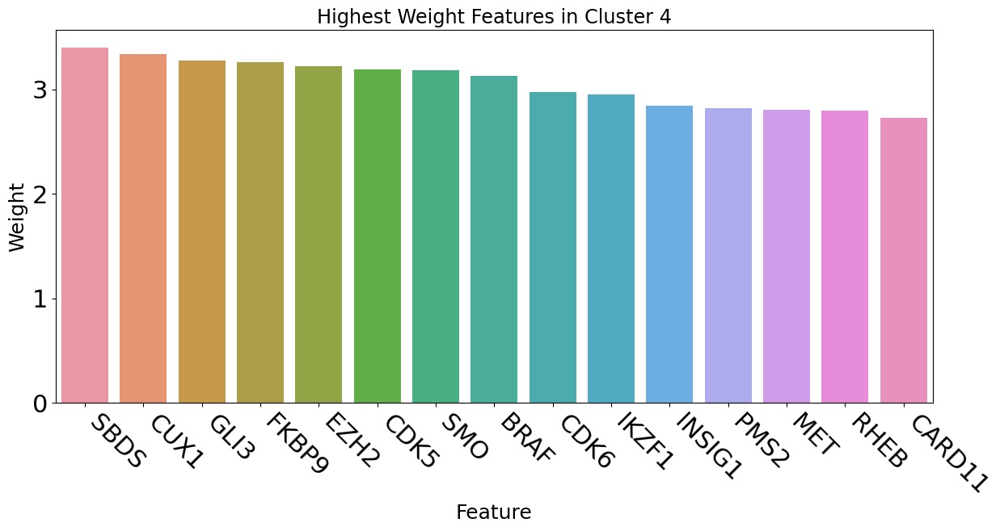

...

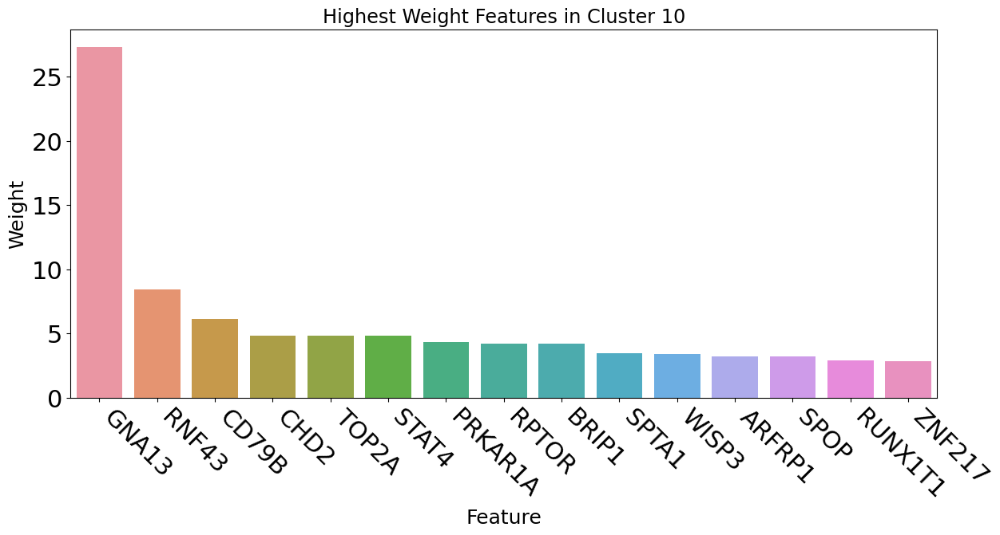

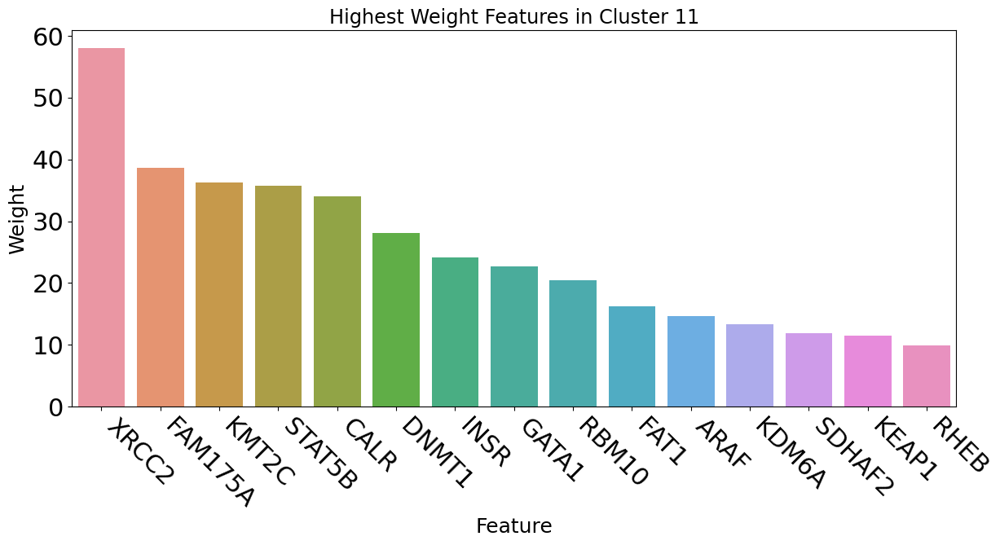

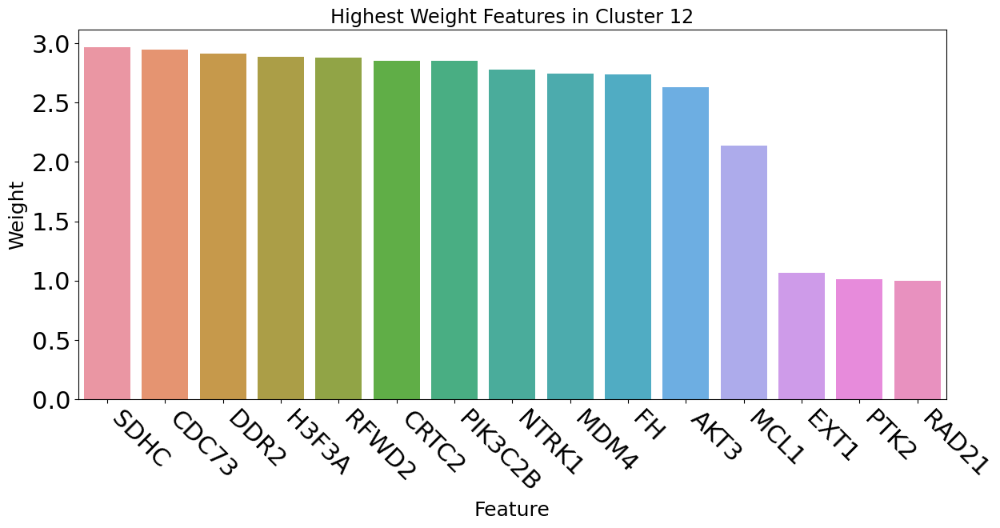

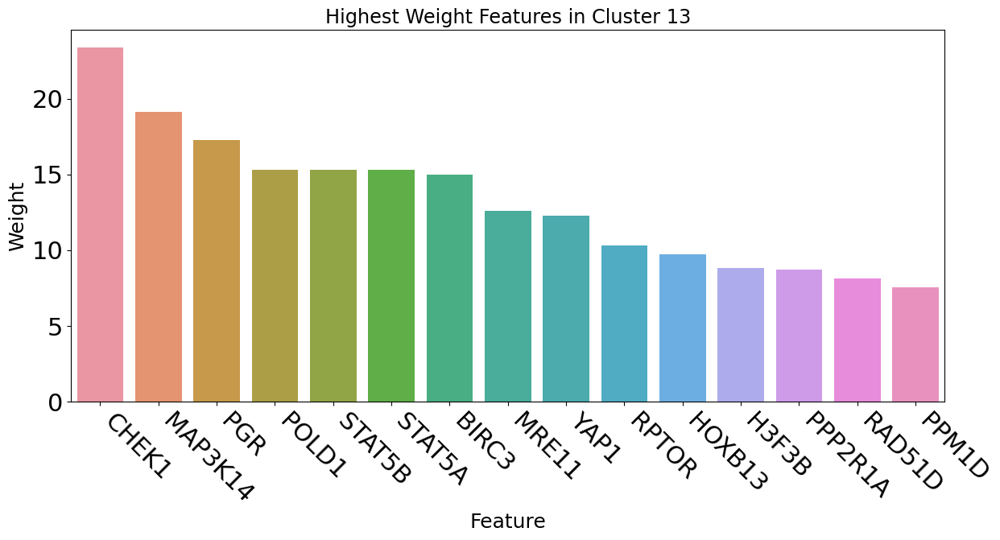

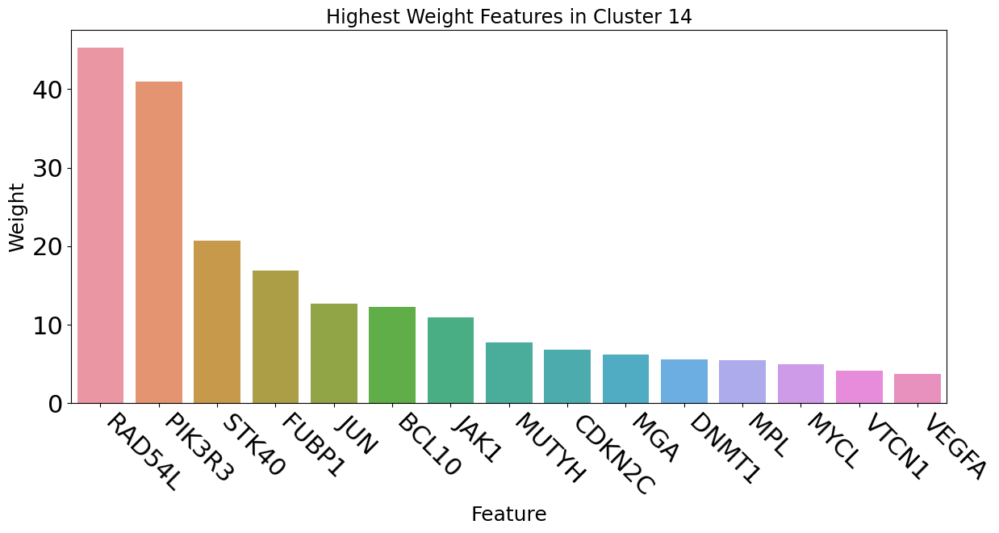

In [121]:
for cluster_label, feature_weights in kms.feature_importances_.items():    
    df_feature_weight = pd.DataFrame(feature_weights[:15], columns=["Feature", "Weight"])
    fig, ax = plt.subplots(figsize=(14,6))
    sns.barplot(x="Feature", y="Weight", data=df_feature_weight)
    plt.xticks(rotation=-45, ha="left");
    ax.tick_params(axis='both', which='major', labelsize=22)
    plt.title(f'Highest Weight Features wcss_min in Cluster {cluster_label}', fontsize='xx-large')
    plt.xlabel('Feature', fontsize=18)
    plt.ylabel('Weight', fontsize=18)

    plt.show();
    
    print('\n\n')

In [134]:

kms = KMeansInterp(
    n_clusters=num_classes, # Set the number of clusters to the number of actual unique categories
    random_state=1, 
    ordered_feature_names=features, # This method gets the feature names (Words) from
    feature_importance_method='unsup2sup', # Or 'unsup2sup'
).fit(df_clinical_CNA_scaled[features])

# Create a new column to the dataset which will have cluster labels
labels = kms.labels_
df_clinical_CNA['Cluster_kms_unsup2sup'] = labels

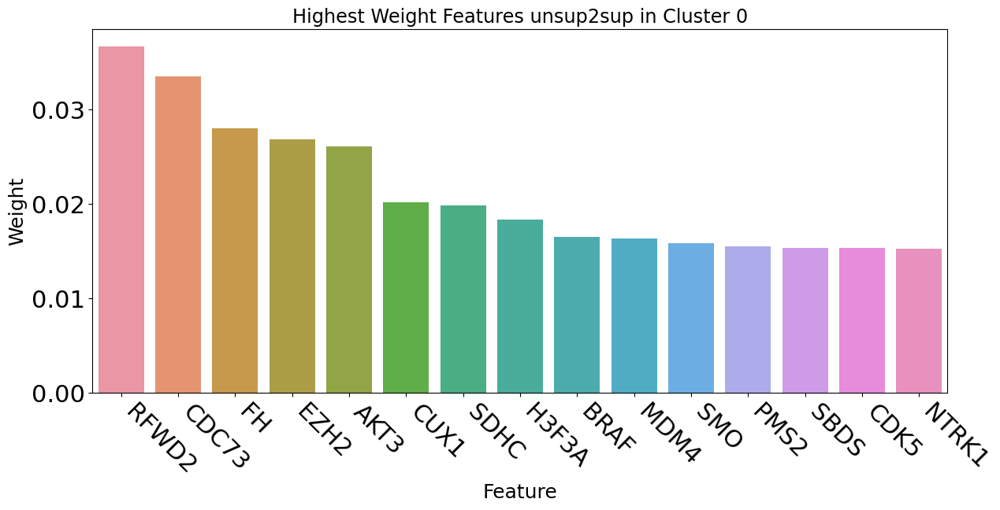

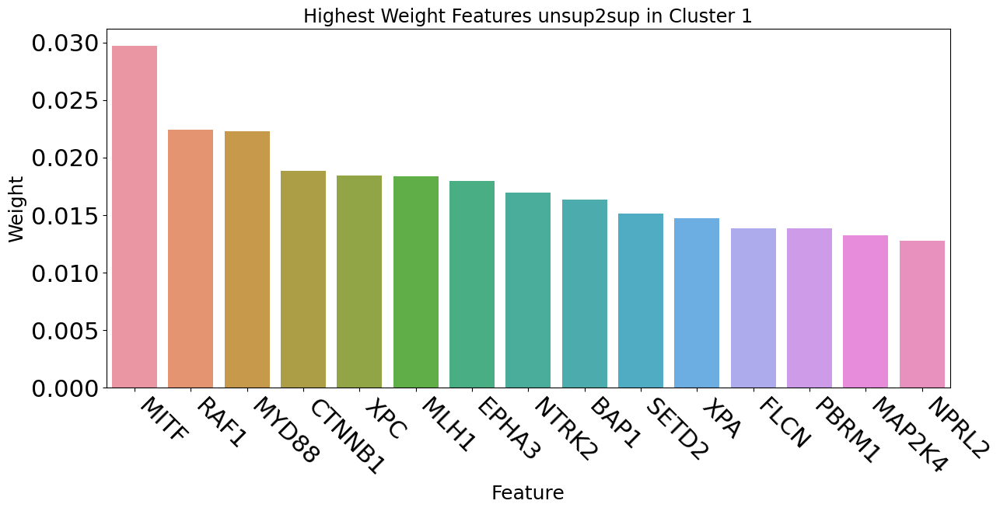

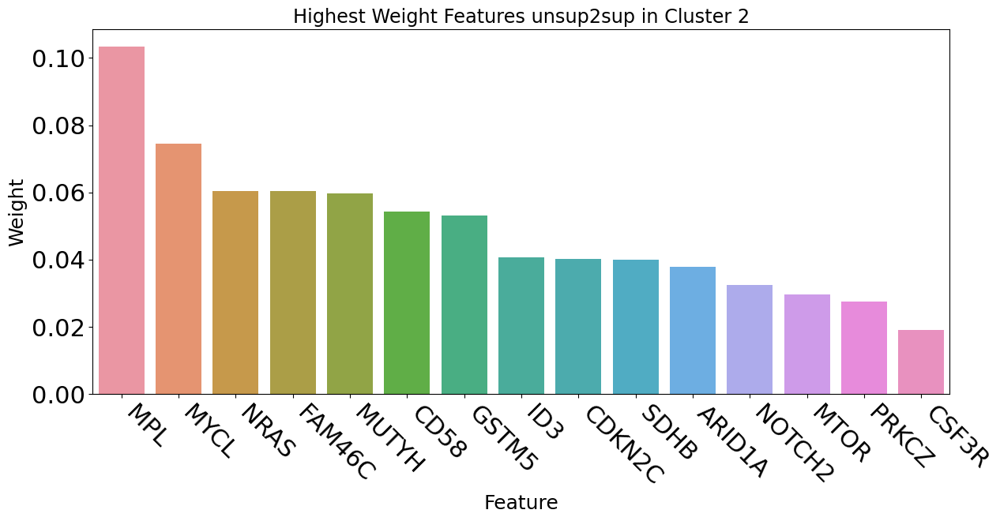

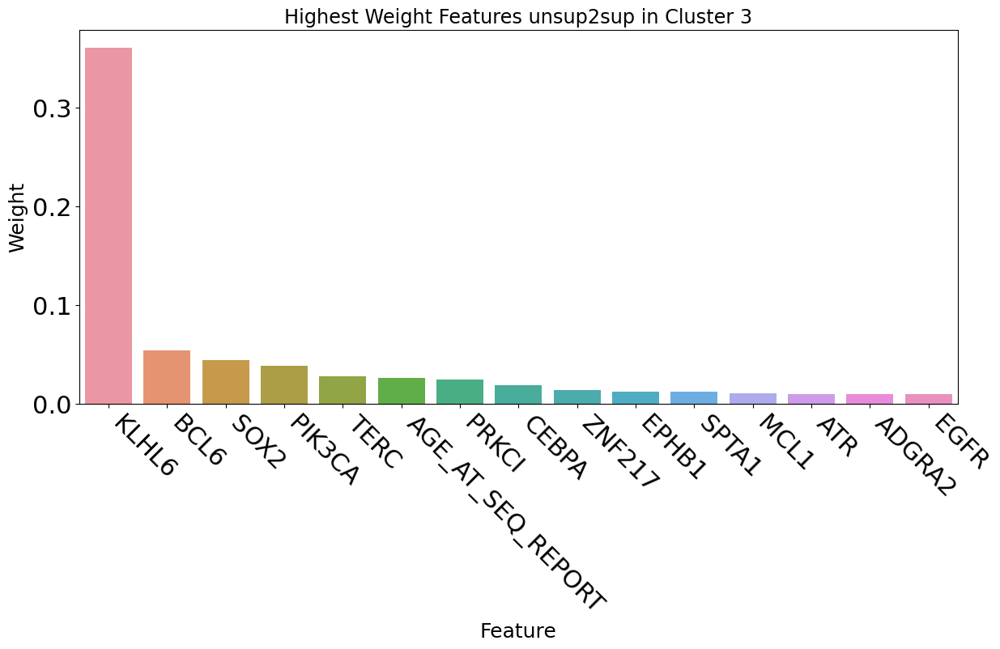

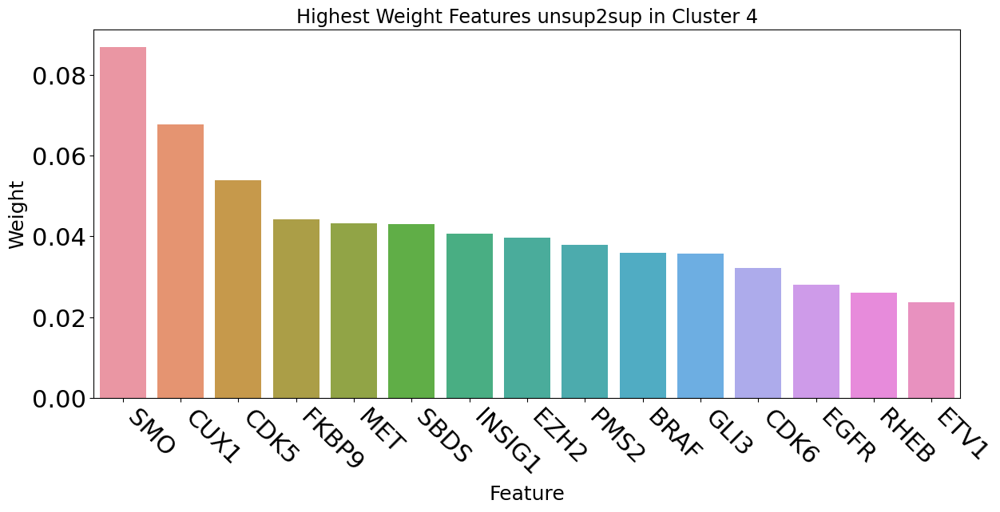

...

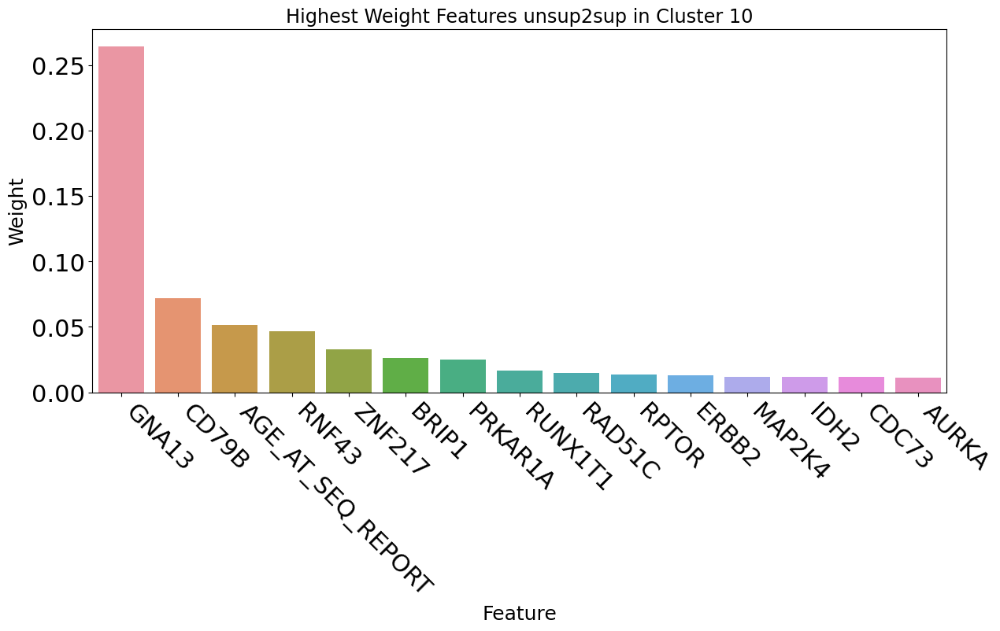

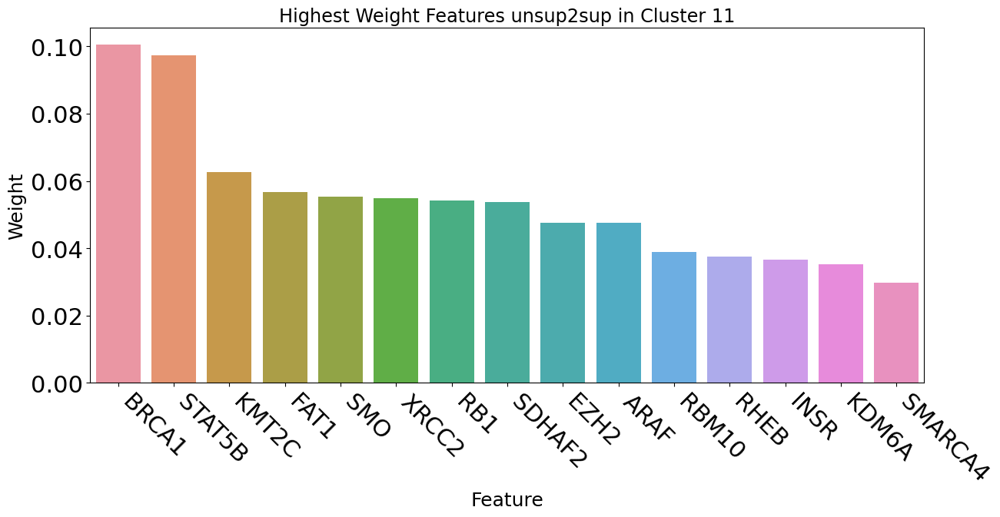

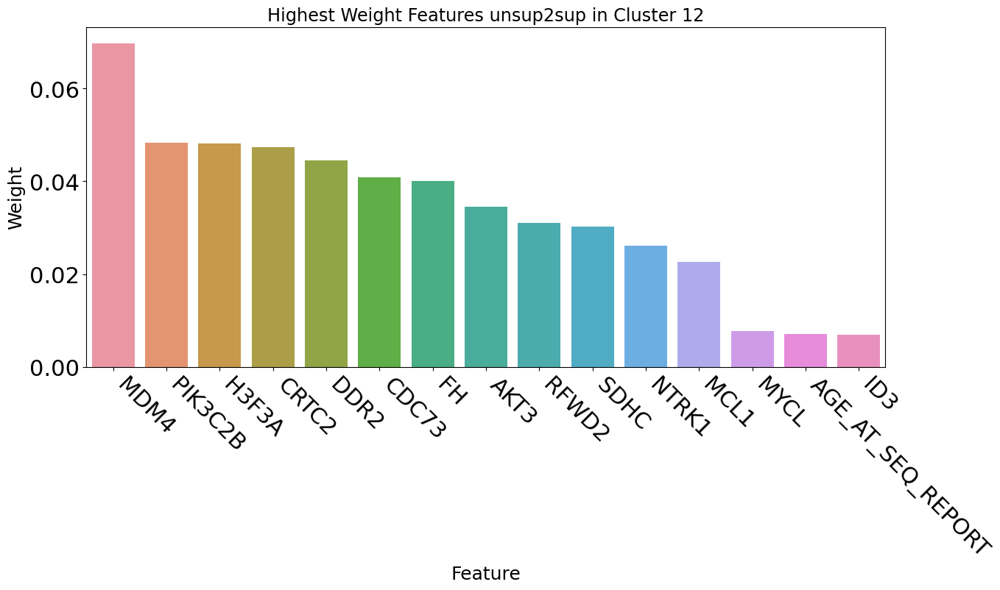

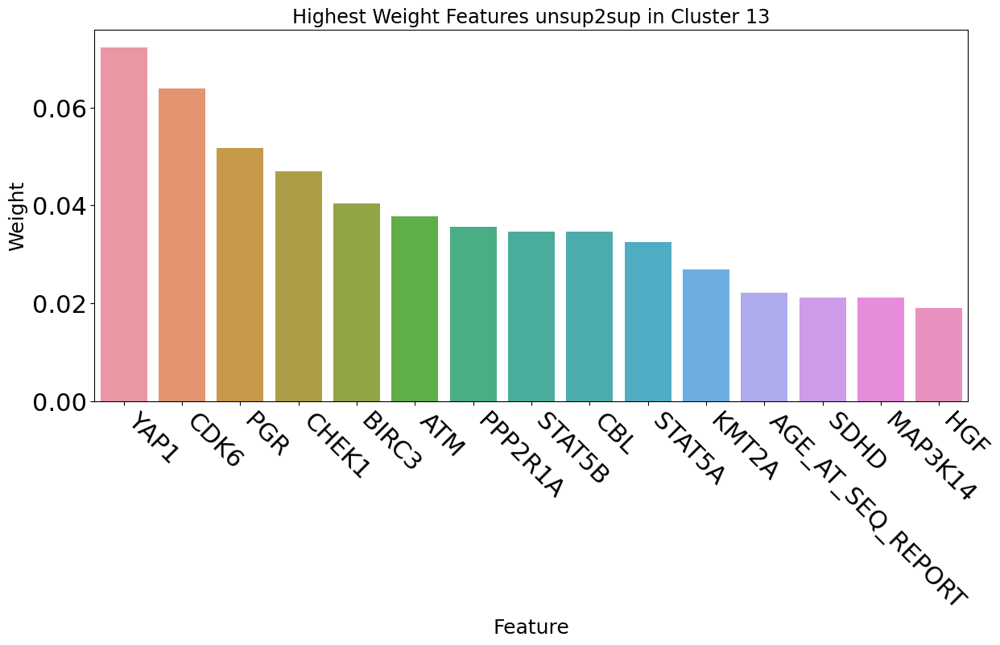

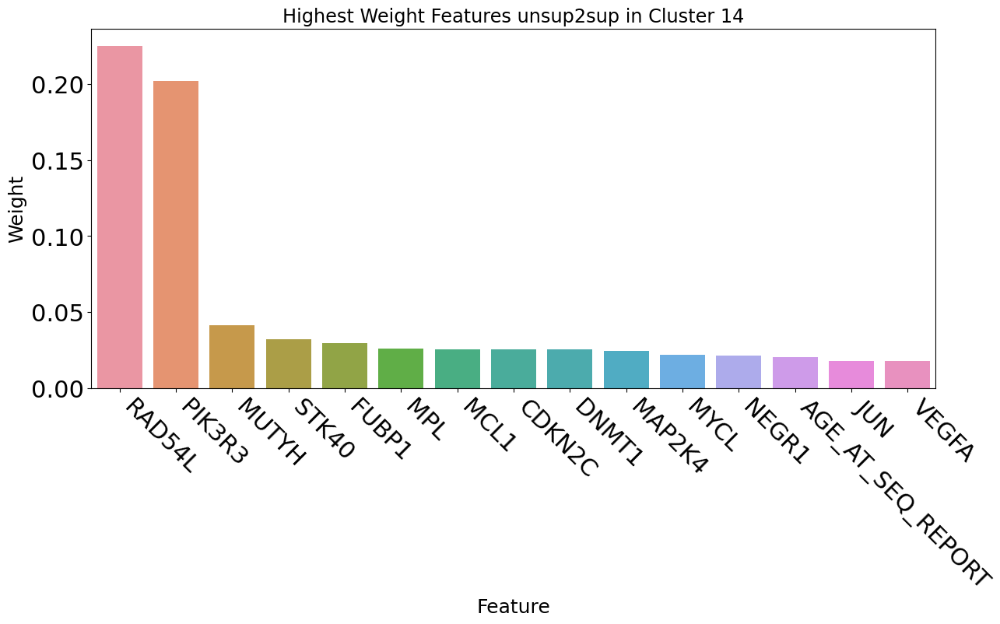

In [135]:
for cluster_label, feature_weights in kms.feature_importances_.items():    
    df_feature_weight = pd.DataFrame(feature_weights[:15], columns=["Feature", "Weight"])
    fig, ax = plt.subplots(figsize=(14,6))
    sns.barplot(x="Feature", y="Weight", data=df_feature_weight)
    plt.xticks(rotation=-45, ha="left");
    ax.tick_params(axis='both', which='major', labelsize=22)
    plt.title(f'Highest Weight Features unsup2sup in Cluster {cluster_label}', fontsize='xx-large')
    plt.xlabel('Feature', fontsize=18)
    plt.ylabel('Weight', fontsize=18)

    plt.show();
    
    print('\n\n')

In [140]:
y_actu = df_clinical_CNA['Cluster_kms_wcss_min']
y_pred = df_clinical_CNA['Cluster_kms_unsup2sup']
#cm = metrics.confusion_matrix(y_actu, y_pred)

In [153]:
df_confusion = pd.crosstab(y_actu, y_pred, rownames=['Cluster_kms_wcss_min'], colnames=['Cluster_kms_unsup2sup'])
#df_confusion = pd.crosstab(y_actu, y_pred, rownames=['Cluster_kms_wcss_min'], colnames=['Cluster_kms_unsup2sup'], margins=True)

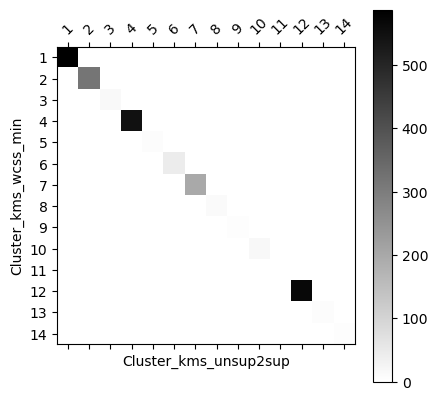

In [160]:
def plot_confusion_matrix(df_confusion, title='Confusion matrix', cmap=plt.cm.gray_r):
    plt.matshow(df_confusion, cmap=cmap) # imshow
    #plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(df_confusion.columns))
    plt.xticks(tick_marks, df_confusion.columns, rotation=45)
    plt.yticks(tick_marks, df_confusion.index)
    #plt.tight_layout()
    plt.ylabel(df_confusion.index.name)
    plt.xlabel(df_confusion.columns.name)


plot_confusion_matrix(df_confusion.loc[1:,1:])

In [216]:
import httplib2 as http
import json

try:
    from urlparse import urlparse
except ImportError:
    from urllib.parse import urlparse

headers = {
'Accept': 'application/json',
}

uri = 'http://rest.genenames.org'
path = '/fetch/hgnc_id/7765'

target = urlparse(uri+path)
method = 'GET'
body = ''

h = http.Http()

response, content = h.request(
target.geturl(),
method,
body,
headers)

if response['status'] == '200':
# assume that content is a json reply
# parse content with the json module 
    data = json.loads(content)
    print('Symbol:' + data['response']['docs'][0]['symbol'])

else:
    print('Error detected: ' + response['status'])


Symbol:NF1


In [217]:
data

{'responseHeader': {'status': 0, 'QTime': 0},
 'response': {'numFound': 1,
  'start': 0,
  'docs': [{'hgnc_id': 'HGNC:7765',
    'symbol': 'NF1',
    'name': 'neurofibromin 1',
    'status': 'Approved',
    'locus_type': 'gene with protein product',
    'alias_name': ['neurofibromatosis',
     'von Recklinghausen disease',
     'Watson disease'],
    'location': '17q11.2',
    'date_approved_reserved': '1986-01-01T00:00:00Z',
    'date_modified': '2021-05-26T00:00:00Z',
    'date_name_changed': '2008-07-31T00:00:00Z',
    'entrez_id': '4763',
    'mgd_id': ['MGI:97306'],
    'cosmic': 'NF1',
    'orphanet': 123772,
    'pubmed_id': [1715669],
    'refseq_accession': ['NM_000267'],
    'gene_group': ['Armadillo like helical domain containing'],
    'vega_id': 'OTTHUMG00000132871',
    'lsdb': ['Global Variome shared LOVD|https://databases.lovd.nl/shared/genes/NF1',
     'LRG_214|http://ftp.ebi.ac.uk/pub/databases/lrgex/LRG_214.xml'],
    'ensembl_gene_id': 'ENSG00000196712',
    'ccds_i

In [218]:
uri = 'http://marrvel.org/data'
path = '/gene/taxonId/9606/entrezId/4763'

target = urlparse(uri+path)
method = 'GET'
body = ''

h = http.Http()

response, content = h.request(
target.geturl(),
method,
body,
headers)

In [220]:
data = json.loads(content)
data

{'alias': ['NFNS', 'VRNF', 'WSS'],
 'pharosTargetIds': [13883],
 'chr': '17',
 'type': 'protein-coding',
 'name': 'neurofibromin 1',
 'lastModified': '20201011',
 'phenotypes': [{'id': 'HP:0011803',
   'ontology': {'id': 'HP:0011803',
    'categories': [{'id': 6, 'name': 'Head and Neck'}],
    'name': 'Bifid nose'}},
  {'id': 'HP:0000957',
   'ontology': {'id': 'HP:0000957',
    'categories': [{'id': 5, 'name': 'Integument'}],
    'name': 'Cafe-au-lait spot'}},
  {'id': 'HP:0002897',
   'ontology': {'id': 'HP:0002897',
    'categories': [{'id': 15, 'name': 'Endocrine'}],
    'name': 'Parathyroid adenoma'}},
  {'id': 'HP:0000233',
   'ontology': {'id': 'HP:0000233',
    'categories': [{'id': 6, 'name': 'Head and Neck'}],
    'name': 'Thin vermilion border'}},
  {'id': 'HP:0001639',
   'ontology': {'id': 'HP:0001639',
    'categories': [{'id': 10, 'name': 'Cardiovascular'}],
    'name': 'Hypertrophic cardiomyopathy'}},
  {'id': 'HP:0001067',
   'ontology': {'id': 'HP:0001067',
    'categ

In [221]:
data["entrezSummary"]

'This gene product appears to function as a negative regulator of the ras signal transduction pathway. Mutations in this gene have been linked to neurofibromatosis type 1, juvenile myelomonocytic leukemia and Watson syndrome. The mRNA for this gene is subject to RNA editing (CGA>UGA->Arg1306Term) resulting in premature translation termination. Alternatively spliced transcript variants encoding different isoforms have also been described for this gene. [provided by RefSeq, Jul 2008]'

In [ ]:
filter_1 = df_clinical["is_NF1"]
filter_2 = df_clinical["CANCER_TYPE"]=="Non-Small Cell Lung Cancer"
df_clinical[filter_1&filter_2]

In [ ]:
df_clinical.head()

In [ ]:
df_clinical[df_clinical["ONCOTREE_CODE"]=="NFIB"]

In [ ]:
df_clinical[df_clinical["CANCER_TYPE_DETAILED"]=="Neurofibroma"]

In [ ]:
sample_neuro = df_clinical[df_clinical["CANCER_TYPE_DETAILED"]=="Neurofibroma"]["SAMPLE_ID"].values

In [ ]:
df_fusions.head()

In [ ]:
df_fusions[df_fusions["TUMOR_SAMPLE_BARCODE"].isin(sample_neuro)]

In [ ]:
list(sample_neuro)

In [ ]:
df_CNA.head()

In [ ]:
len(df_CNA.columns)

In [ ]:
df_CNA[df_CNA["HUGO_SYMBOL"]=="NF1"]

In [ ]:
df_CNA["GENIE-DFCI-002343-5267"].describe()

In [ ]:
df_CNA["GENIE-DFCI-004738-3279"].describe()

In [ ]:
#df_CNA["GENIE-MDA-2134-4189"]

In [ ]:
df_mutations.head()

In [ ]:
df_mutations[df_mutations["Tumor_Sample_Barcode"]=="GENIE-DFCI-002343-5267"]

In [ ]:
df_mutations[df_mutations["Tumor_Sample_Barcode"]=="GENIE-DFCI-004738-3279"]

In [ ]:
df_mutations[df_mutations["Tumor_Sample_Barcode"]=="GENIE-MDA-2134-4189"]